# 3DeeCellTracker Demo: Train 3D U-Net
This notebook shows how to use 3DeeCellTracker to train a 3D U-Net.
The demo data can be found in the "unet_training" folder downloaded from https://osf.io/dt76c/

The basic procedures:

- A. Import packages
- B. Initialize the parameters for training
- C. Load the train / validation datasets
- D. Preprocess the datasets
- E. Train the 3D U-Net
- F. Select the best weights and save the model

Please run following codes according to the instructions

## A. Import packages

In [1]:
%load_ext autoreload
%autoreload 2
import os
import warnings
warnings.filterwarnings('ignore')
from CellTracker.unet3d import TrainingUNet3D, unet3_a
%matplotlib inline

## B. Initialize the parameters for training
- noise_level: This value should be roughly the intensity of the background pixels in the raw image. It is used in
normalization to enhance the cells with weak intensity while ignore the background noises. If the two images (train and
validation) have different noise level, choose a value somehow between them.

- folder_path: This path is used to create a folder (if not exist) to store the data and model files. We recommend users
to set it as “./xxxx” to create a folder named xxxx under the same directory containing the notebook file.

- model: This should be a predefined 3D U-Net model. The simplest way is to use the default value unet3_a(). Advanced
users can select other predefined model such as unet3_b(), unet3_c(), or a model defined by themselves (need to modify
the “Import packages” cell to import the model).

In [2]:
trainer = TrainingUNet3D(noise_level=100, folder_path=os.path.abspath("./unet_01"), model=unet3_a())

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Made folders under: C:\Users\vislabwwy\BAAI-Dev\3dct_for_pku_ldg\Examples
Following folders were made: 
unet_01\train_image
unet_01\train_label
unet_01\valid_image
unet_01\valid_label
unet_01\models
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


## C. Load the train / validation datasets

After running B, the program automatically generated several folders under the folder_path. Users should prepare the
training data and validation data (see examples in the demo data) and store them into the “train_image”(raw 2D image
sequence for training data), “train_label”(2D annotation of cell/non-cell regions for training data), “valid_image” and
“valid_label” (for validation data), respectively.


Run the code cell. The program will load and draw the images/annotations of the training and validation dataset by max-projection.

Load images with shape: (512, 1024, 21)
Load images with shape: (512, 1024, 21)
Load images with shape: (512, 1024, 21)
Load images with shape: (512, 1024, 21)


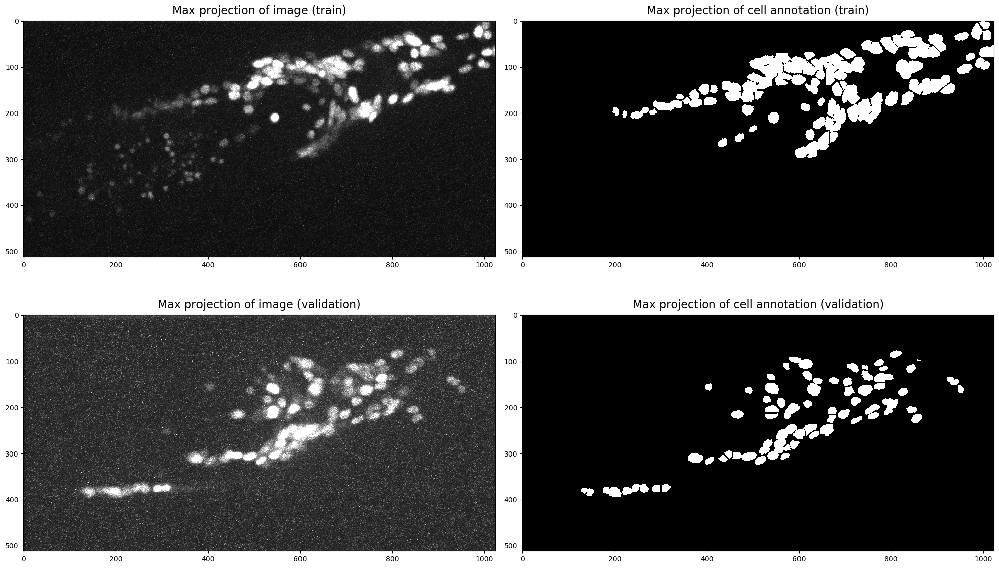

In [3]:
trainer.load_dataset()
trainer.draw_dataset()

## D. Preprocess the datasets
**D1. Show the normalized images (max projection)**

Normalize the images and show the normalized images.
If the normalization looks poor, e.g. the background look too bright, or the intensity of weak cells are not enhanced.
Please go back to step B to modify the parameter “noise_level” and run all codes again.

Images were normalized
Images were divided
Data for training 3D U-Net were prepared


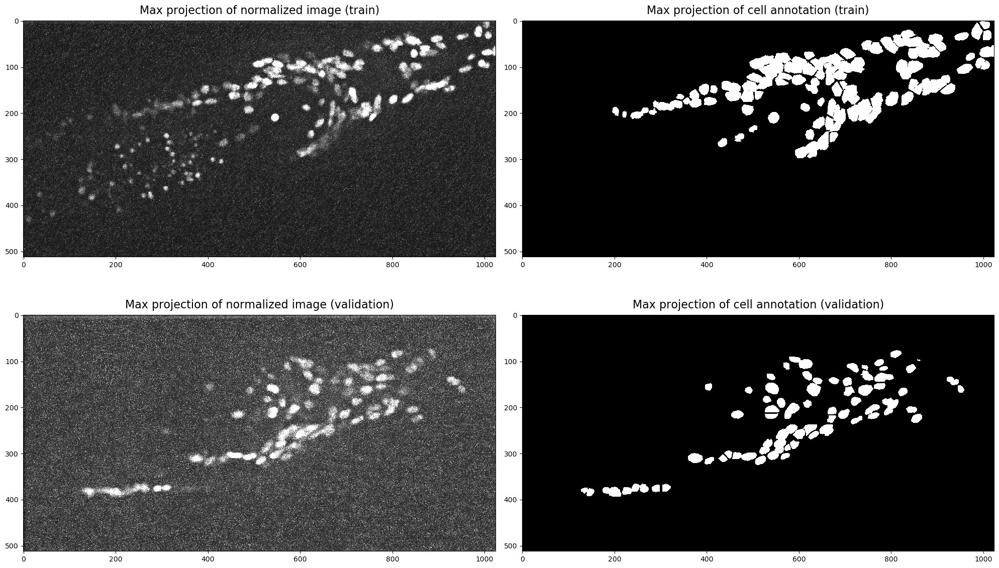

In [4]:
trainer.preprocess()
trainer.draw_norm_dataset()

**D2. Show the divided images (part)**

Divide the images into multiple sub-images (used as the input of 3D U-Net) and show a part of these sub-images.

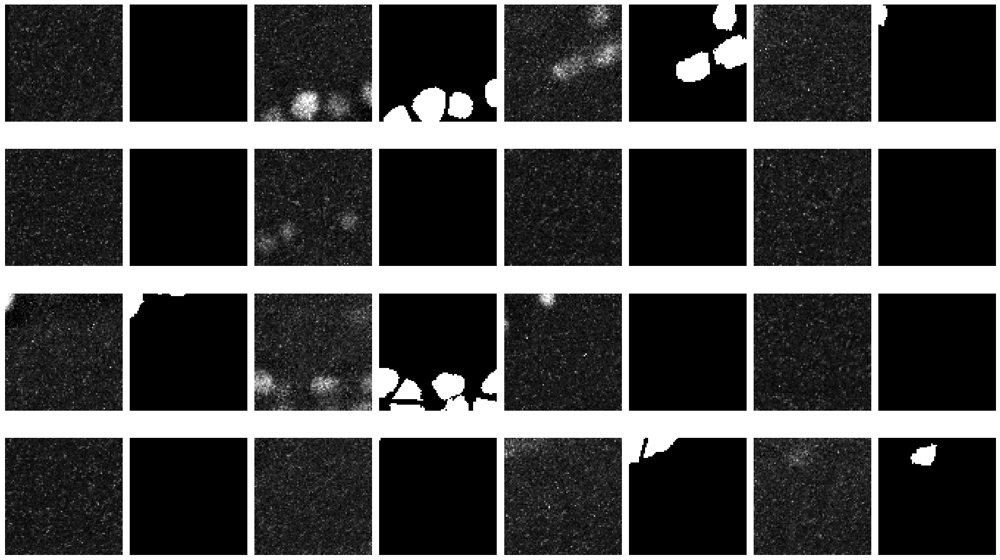

In [5]:
trainer.draw_divided_train_data()

## E. Train the 3D U-Net
Start to train the 3D U-Net. During the training, the program will draw the updated prediction of cell regions if the
loss on validation data is reduced.

By default, the program will train for 100 epochs. Users can manually stop the training by pressing Ctrl+C if the
val_loss no longer decreases anymore.

60/60 [==============================] - 17s 285ms/step - loss: 0.6428 - val_loss: 0.4898
val_loss at step 1:  0.4897903484549928


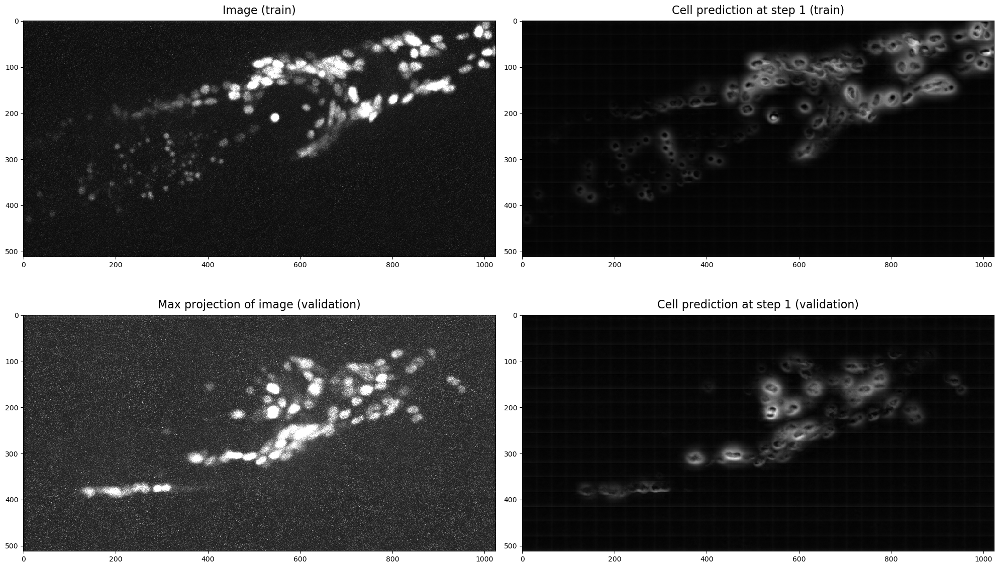

60/60 [==============================] - 12s 198ms/step - loss: 0.5155 - val_loss: 0.4176
val_loss updated from  0.4897903484549928  to  0.41763747087184416


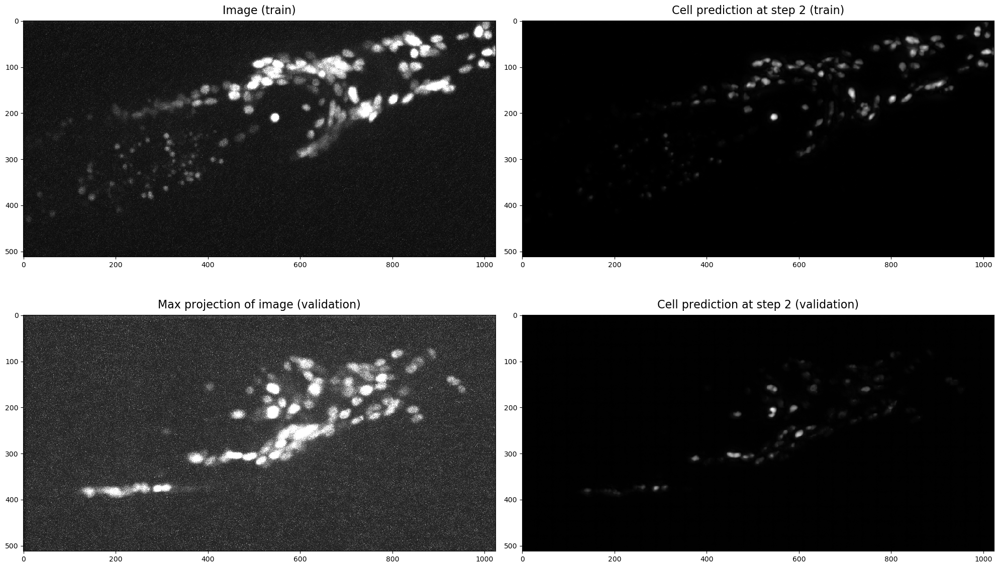

60/60 [==============================] - 12s 198ms/step - loss: 0.4020 - val_loss: 0.3101
val_loss updated from  0.41763747087184416  to  0.3100820427879374


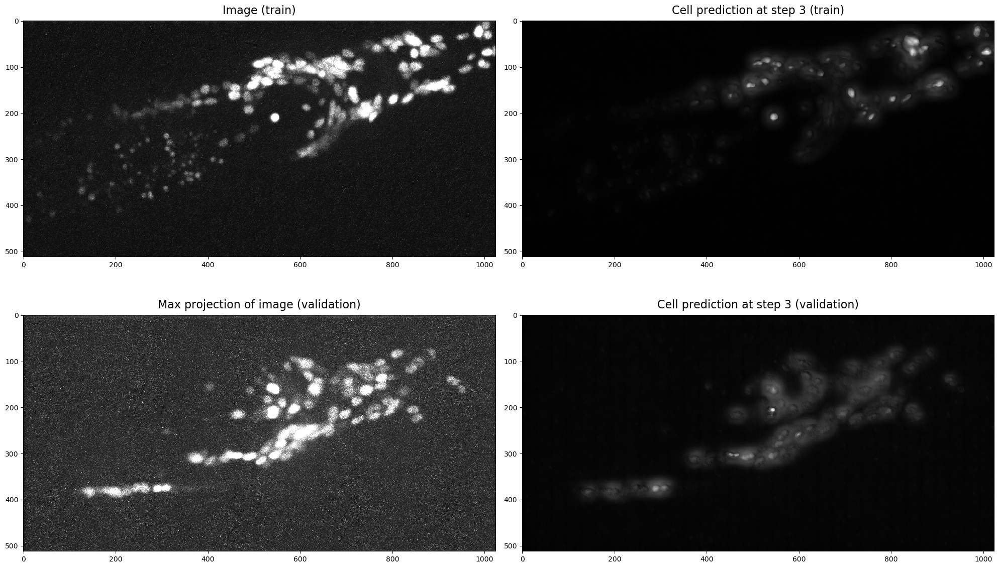

60/60 [==============================] - 12s 198ms/step - loss: 0.2996 - val_loss: 0.2157
val_loss updated from  0.3100820427879374  to  0.21565732225141626


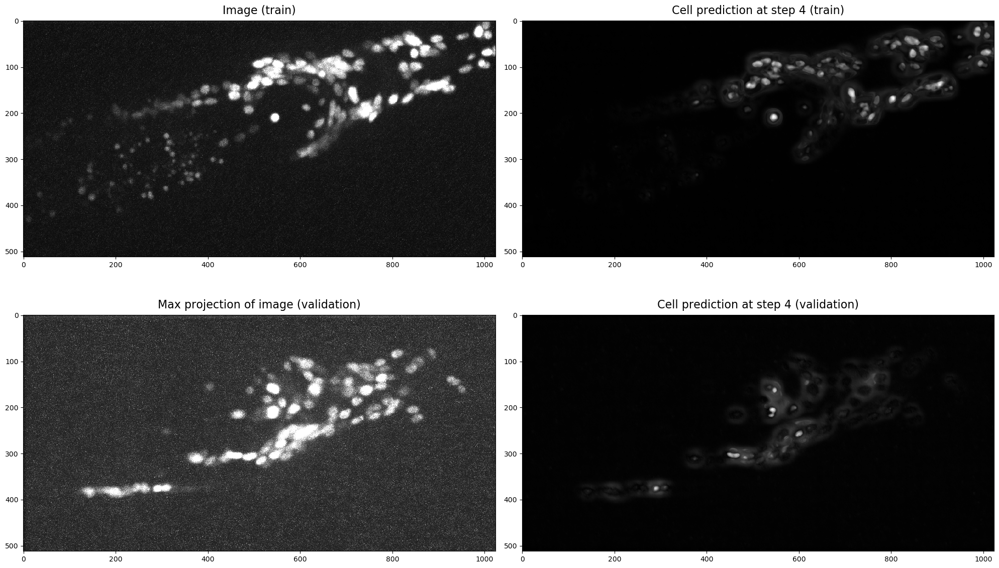

60/60 [==============================] - 12s 198ms/step - loss: 0.2236 - val_loss: 0.1363
val_loss updated from  0.21565732225141626  to  0.13627778810072452


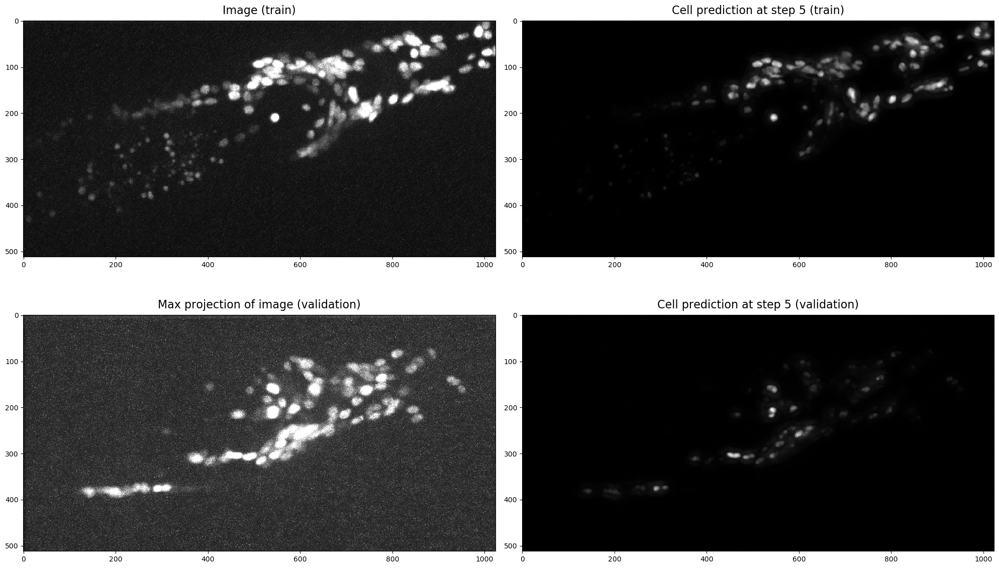

60/60 [==============================] - 12s 198ms/step - loss: 0.1634 - val_loss: 0.1318
val_loss updated from  0.13627778810072452  to  0.13184787107116364


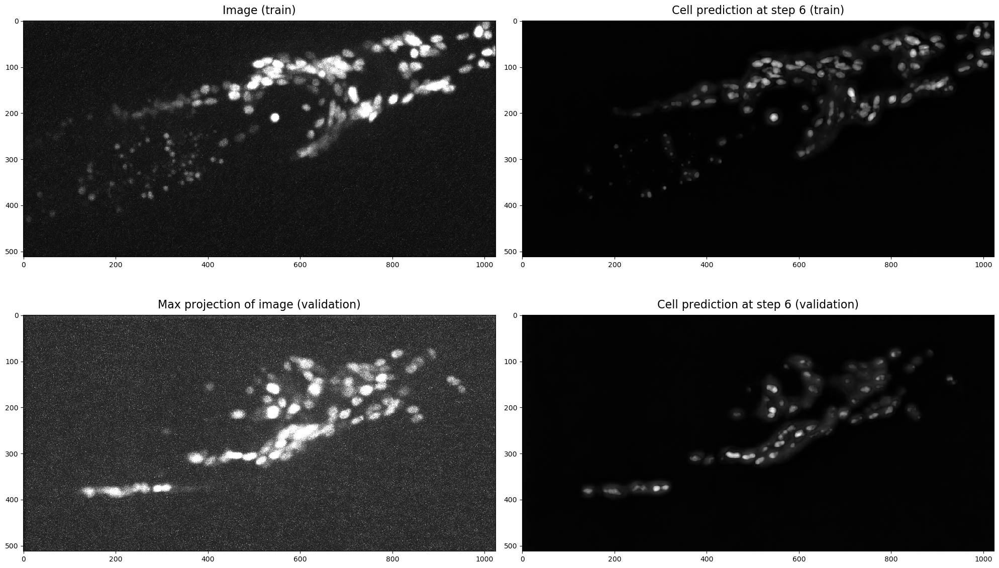

60/60 [==============================] - 12s 198ms/step - loss: 0.1197 - val_loss: 0.0949
val_loss updated from  0.13184787107116364  to  0.09489403942481


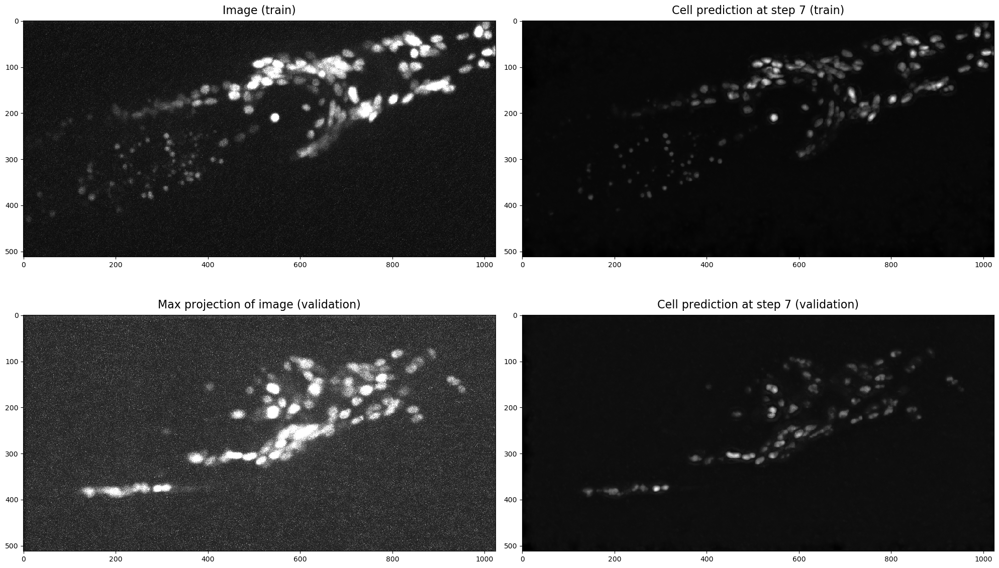

60/60 [==============================] - 12s 196ms/step - loss: 0.0971 - val_loss: 0.0763
val_loss updated from  0.09489403942481  to  0.07634012896488322


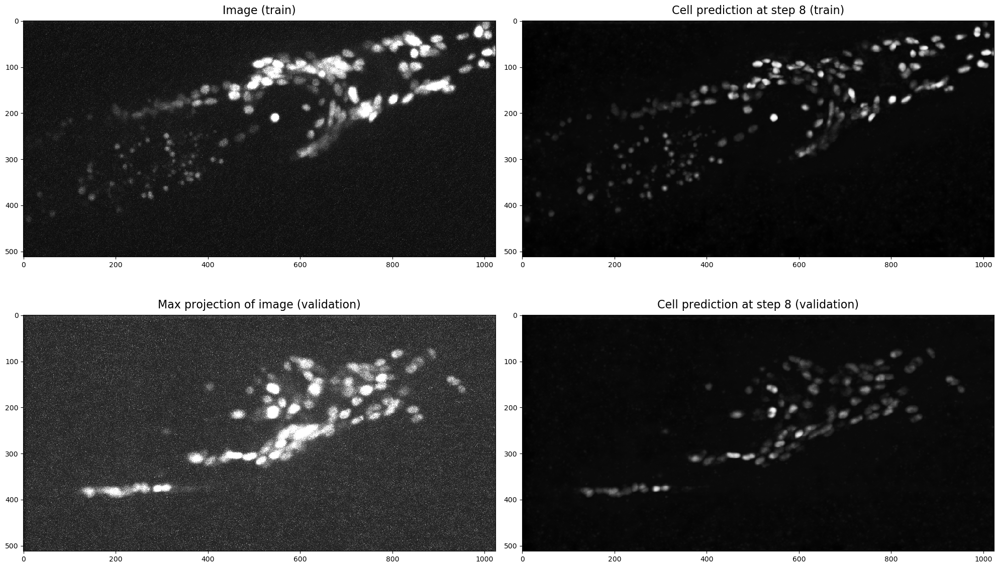

60/60 [==============================] - 12s 193ms/step - loss: 0.0725 - val_loss: 0.0611
val_loss updated from  0.07634012896488322  to  0.06111326132048952


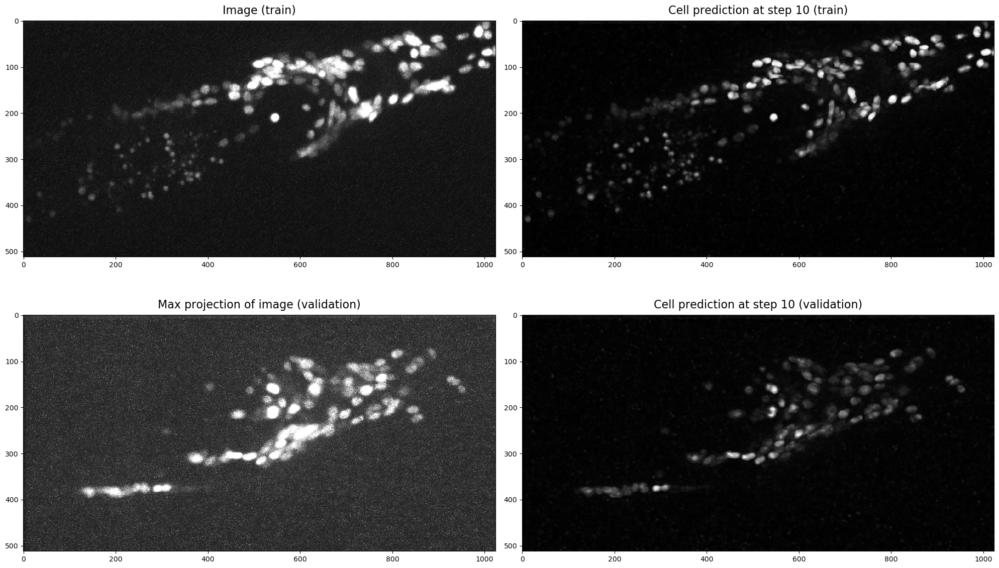

60/60 [==============================] - 12s 194ms/step - loss: 0.0575 - val_loss: 0.0397
val_loss updated from  0.06111326132048952  to  0.0396955319918058


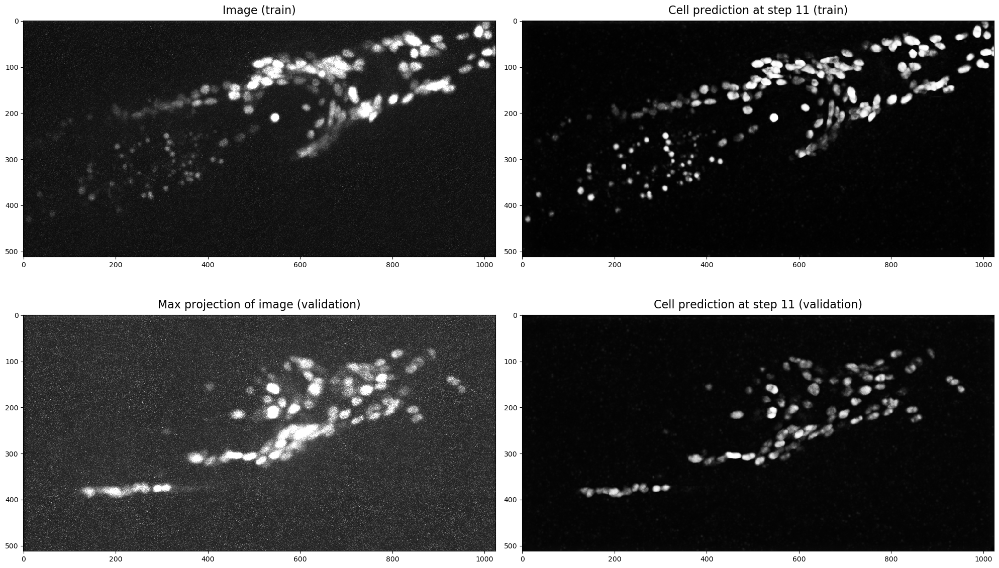

60/60 [==============================] - 12s 197ms/step - loss: 0.0491 - val_loss: 0.0303
val_loss updated from  0.0396955319918058  to  0.030308047319425546


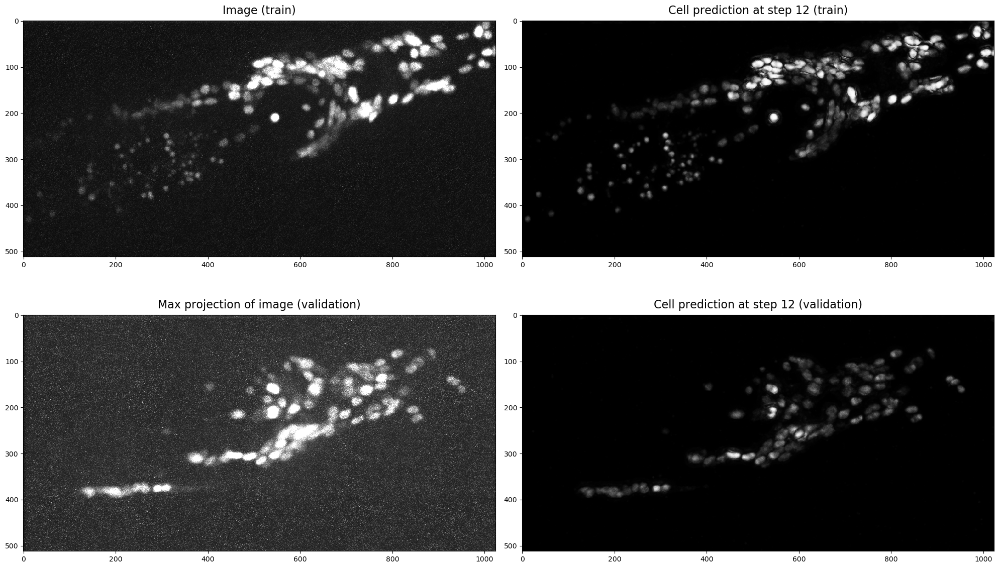

60/60 [==============================] - 12s 194ms/step - loss: 0.0480 - val_loss: 0.0213
val_loss updated from  0.030308047319425546  to  0.02131063388066089


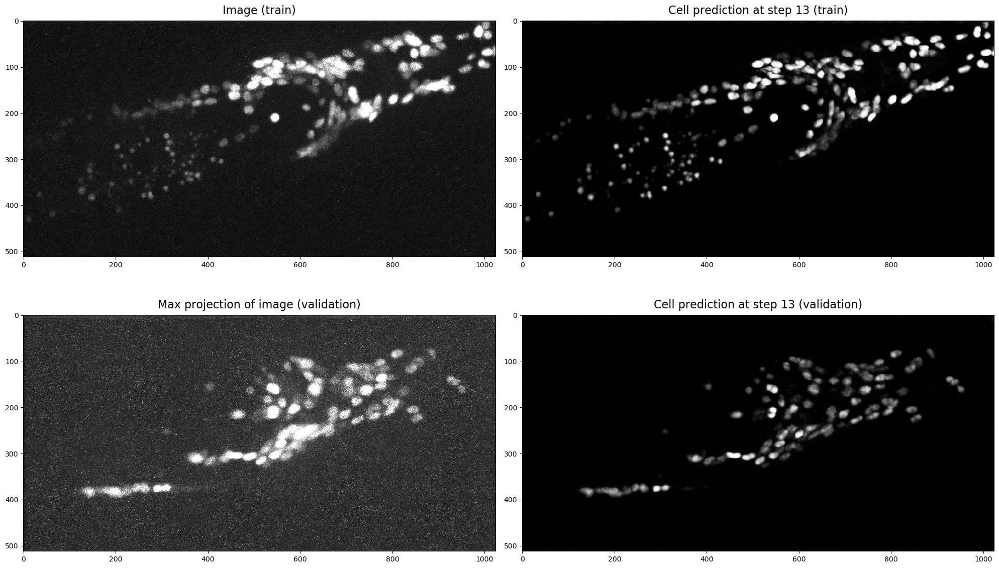

60/60 [==============================] - 12s 196ms/step - loss: 0.0373 - val_loss: 0.0100
val_loss updated from  0.02131063388066089  to  0.010023936419995463


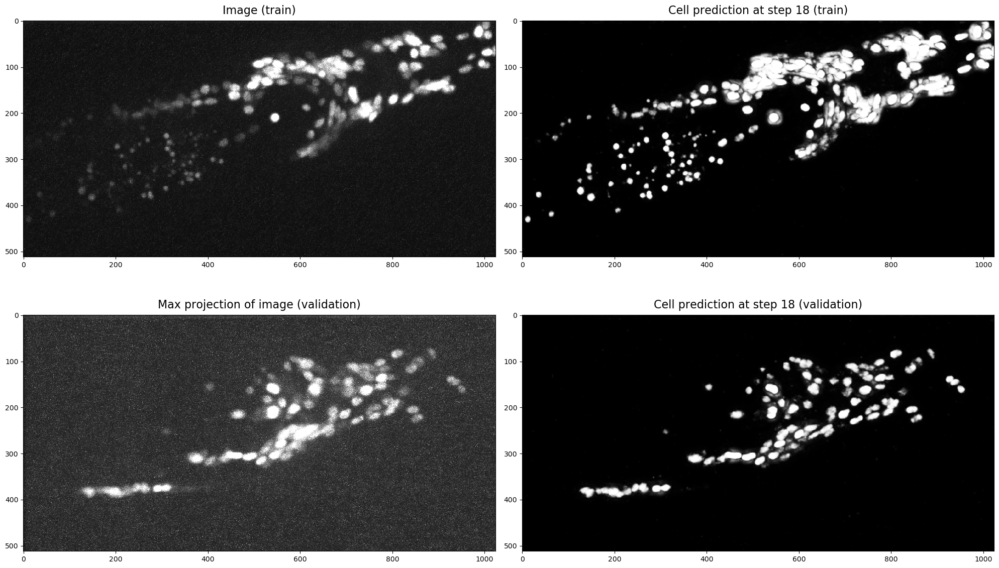

60/60 [==============================] - 12s 198ms/step - loss: 0.0297 - val_loss: 0.0080
val_loss updated from  0.010023936419995463  to  0.00802775008382246


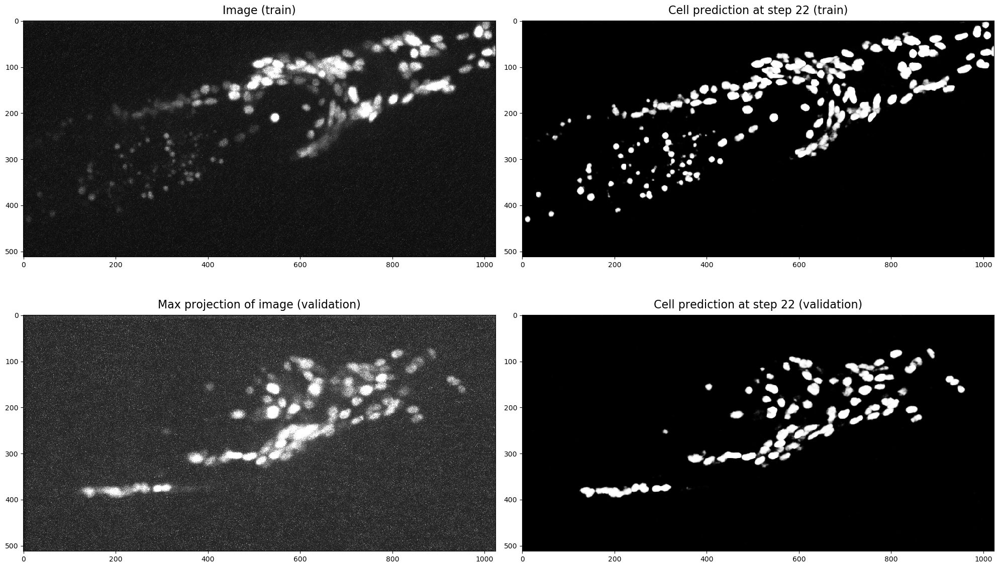

60/60 [==============================] - 12s 196ms/step - loss: 0.0168 - val_loss: 0.0074
val_loss updated from  0.00802775008382246  to  0.007368133709725101


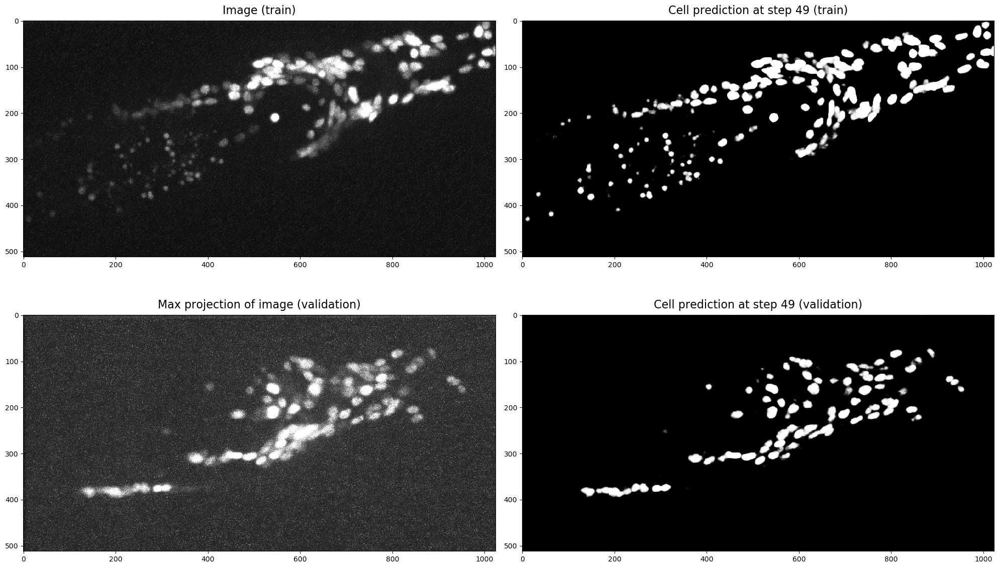

60/60 [==============================] - 12s 197ms/step - loss: 0.0186 - val_loss: 0.0070
val_loss updated from  0.007368133709725101  to  0.007009238528475992


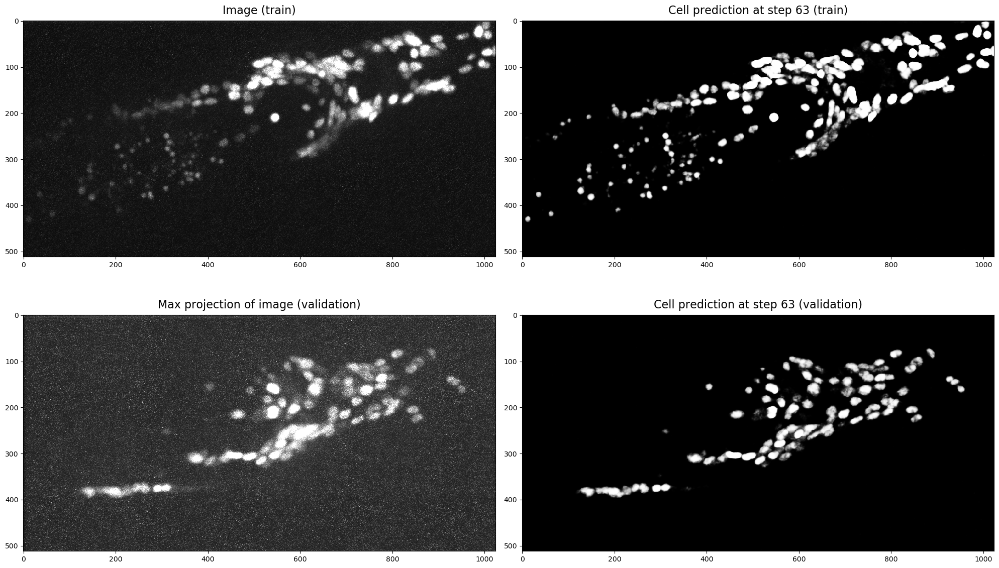

60/60 [==============================] - 12s 196ms/step - loss: 0.0160 - val_loss: 0.0069
val_loss updated from  0.007009238528475992  to  0.006868574278416147


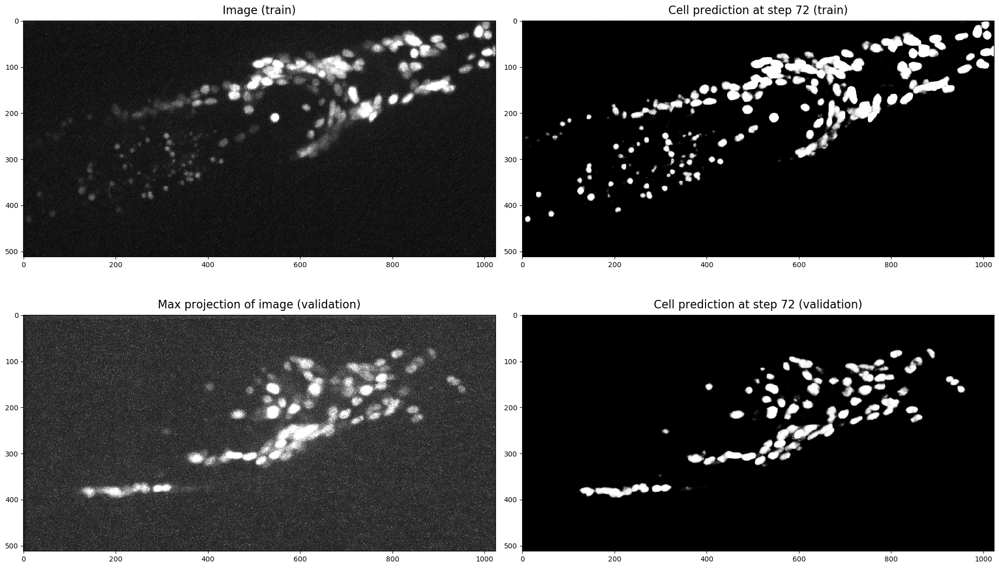

60/60 [==============================] - 12s 196ms/step - loss: 0.0163 - val_loss: 0.0065
val_loss updated from  0.006868574278416147  to  0.0065468549712912796


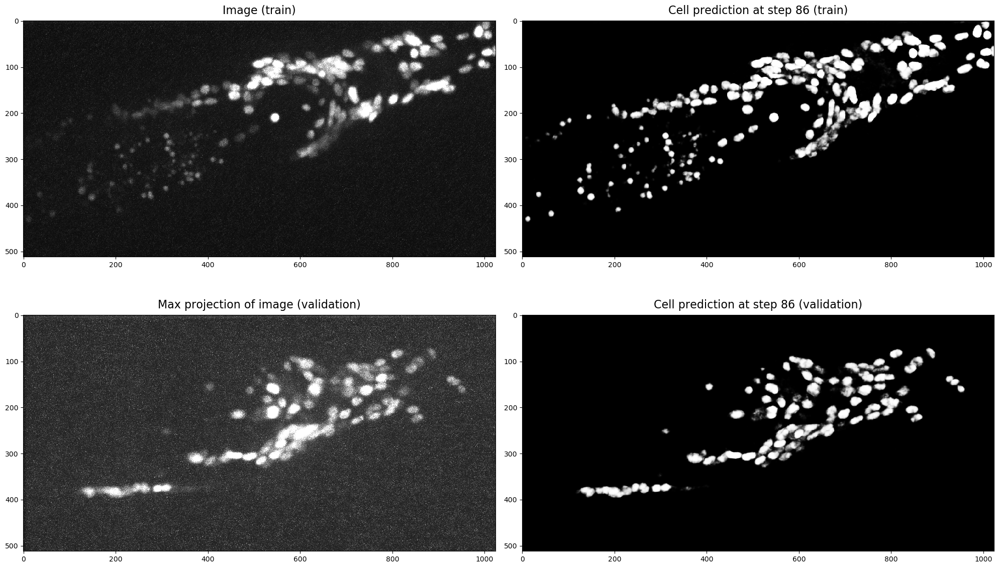

60/60 [==============================] - 12s 197ms/step - loss: 0.0136 - val_loss: 0.0087


In [6]:
trainer.train()

## F. Select the best weights and save the model
After training finished or manually stopped. Users should choose the best step which generate the best prediction of
cell regions. Usually this should be the one with the lowest val_loss, but uses can select other step instead.

The program will store the model with the chosen weights into the “models” folder with the name “unet3_pretrained.h5”

In [8]:
trainer.select_weights(step=86)